In [1]:
import scipy.io
import cv2
from BlockSync2 import *
import numpy as np
import pandas as pd
import scipy.io as io
import pathlib
import os
import sys
from matplotlib import pyplot as plt
import seaborn as sns
from open_ephys import analysis as oea
import bokeh
from bokeh.io import output as b_output
from bokeh.models import formatters
import scipy.signal as sig
from scipy import stats as st
from scipy.ndimage import median_filter as median_filter
import scipy.interpolate as interp
import time
from scipy.stats import kde
from UtilityFunctions import *

In [2]:
def get_rising_falling_edges(bool_vec):
    """
    Use this function to understand the rising and falling edges of True/False transitions in bool_vec
    :param bool_vec: some boolean vector describing a condition in the data, for example: df['col_name'].values > threshold
    :return: Rising and falling boolean vectors for epochs where condition is True
    """
    bool_vec = bool_vec.astype(int)
    shift_vec = np.insert(bool_vec[0:-1],0,0).astype(int)
    condition_vec = np.subtract(bool_vec,shift_vec)
    rising_edges = condition_vec == 1
    falling_edges = condition_vec == -1
    return rising_edges, falling_edges

def collect_condition_samples(block,sync_ttls,cond_boolean, data,timestamps):
    """
    For each condition vector inside a block use this function to collect a dataframe with the samples of interest according to the boolean condition
    :param block: a BlockSync object
    :param sync_ttls: The synchronized timestamps associated with the conditional dataframe
    :param cond_boolean: a boolean indicating which timestamps are of interest
    :param data: EP samples
    :param timestamps:EP timestamps
    :return: cdf is a dataframe with the relevant samples for each segment
    """
    rising, falling = get_rising_falling_edges(cond_boolean)
    rising_ttls = sync_ttls[rising].values
    falling_ttls = sync_ttls[falling].values
    # create a "conition" DataFrame
    cdf = pd.DataFrame(data=np.array([rising_ttls, falling_ttls, falling_ttls - rising_ttls]).T,columns=['rising','falling','length'])
    min_length = block.sample_rate
    # treat too short segments
    for ind in range(len(cdf)):
        if cdf.loc[ind,'length'] >= min_length:
            continue
        else:
            mid_ttl = np.floor(np.mean([cdf.loc[ind, 'rising'],cdf.loc[ind,'falling']])).astype(int)
            cdf.at[ind,'rising'] = mid_ttl - min_length//2
            cdf.at[ind,'falling'] = mid_ttl + min_length//2
            cdf.at[ind,'length'] = (mid_ttl + min_length//2) - (mid_ttl - min_length//2)

    cdf.insert(loc=3,column='samples',value=np.nan)
    cdf['samples'] = cdf['samples'].astype(object)
    # go over the dataframe:
    for ind in tqdm(range(len(cdf))):
        # understand the TTls indices:
        rising_ind = np.where(timestamps == cdf.loc[ind,'rising'])[0][0]
        falling_ind = np.where(timestamps == cdf.loc[ind,'falling'])[0][0]
        seg_samples = data[range(rising_ind, falling_ind)]
        cdf.at[ind,'samples']=seg_samples
    cdf['block'] = block.block_num

    return cdf

In [3]:
def block_df_creator(block, gaussian_size):

    if sum(block.re_df['Arena_TTL'] == block.le_df['Arena_TTL']) == len(block.re_df): # check that timestamps are actually aligned
        # get both eye data
        df = block.le_df[['Arena_TTL','ms_axis']] # create a dataframe with joint Arena_TTL vector as EP identifier

        df.insert(loc=1,column='block_num',value=block.block_num) # keep block numbers for later


        # get right eye pupil area values
        right_vals = (block.re_df['ellipse_size']*block.R_pix_size).values
        # smooth them out:
        right_vals = median_filter(right_vals, gaussian_size)
        z_right = (right_vals - np.nanmean(right_vals)) / np.nanstd(right_vals)

        # get left eye values
        left_vals = (block.le_df['ellipse_size']*block.L_pix_size).values
        # smooth them out:
        left_vals = median_filter(left_vals, gaussian_size)
        z_left = (left_vals - np.nanmean(left_vals)) / np.nanstd(left_vals)

        df.insert(loc=1,column='re_pupil_z',value=z_right)
        df.insert(loc=1,column='le_pupil_z',value=z_left)

        return(df)
    else:
        print('problem with timestamps alignment')


def get_single_condition_df(block ,block_df ,condition_boolean, cond_label, segment_length=1):
    """
    This function takes a condition boolean and gets the rising and falling edges of segment length chunks complying with the boolean array
    :param block: BlockSync object
    :param block_df: dataframe containing ['Arena_TTL', 'le_pupil_z', 're_pupil_z', 'block_num', 'ms_axis'], created by block_df_creator
    :param condition_boolean:
    :return:
    """
    df = block_df
    cond_len = block.sample_rate * segment_length # 1 second
    cond_rising = []
    cond_falling = []
    rising, falling = get_rising_falling_edges(condition_boolean)
    rising_ttls = df['Arena_TTL'][rising].values
    falling_ttls = df['Arena_TTL'][falling].values
    if len(rising_ttls) != len(falling_ttls):
        if len(rising_ttls) > len(falling_ttls):
        # This can only happen if the last input is a rising edge so append a falling edge at the end of the data
            falling_ttls = np.append(falling_ttls,rising_ttls[-1]+cond_len)
        else:
            print('you did not expect this')
    segments_length = falling_ttls - rising_ttls
    for i in range(len(segments_length)):
        seg_len = segments_length[i]
        if  seg_len < cond_len:
            continue
        else:
            #calculate how many chunks can be fully extracted:
            chunks = int(seg_len // cond_len)
            for c in range(chunks):
                chunk_starts = rising_ttls[i]+(c*cond_len)
                chunk_ends = chunk_starts + cond_len
                cond_rising.append(chunk_starts)
                cond_falling.append(chunk_ends)
    scdf = pd.DataFrame(data={  'rising':cond_rising,
                                'falling':cond_falling,
                                'block':block.block_num,
                                'cond':cond_label           })
    return scdf

def get_conditions_dataframe_for_matlab_export(blocklist,upper_threshold=1.5,lower_threshold=-1.5,mid_window=[-0.1,0.1], gaussian_size=60):
    """
    This function goes over a blocklist and append a large dataframe containing rising and falling edges, block numbers and condition descriptions for matlab analysis
    :param blocklist: a list containing BlockSync objects
    :param upper_threshold:
    :param lower_threshold:
    :param mid_window:
    :return: df
    """
    # go over all blocks
    large_df = pd.DataFrame(data=None,columns=['rising','falling','block','cond'])
    for block in blocklist:
        print(block.block_num)
        block_df = block_df_creator(block,gaussian_size=gaussian_size)
        upper_boolean_r = block_df['re_pupil_z'].values > upper_threshold
        upper_boolean_l = block_df['le_pupil_z'].values > upper_threshold
        lower_boolean_r = block_df['re_pupil_z'].values < lower_threshold
        lower_boolean_l = block_df['le_pupil_z'].values < lower_threshold
        mid_boolean_r =  (block_df['re_pupil_z'].values > mid_window[0]) & (block_df['re_pupil_z'].values < mid_window[1])
        mid_boolean_l =  (block_df['le_pupil_z'].values > mid_window[0]) & (block_df['le_pupil_z'].values < mid_window[1])
        upper_r_df = get_single_condition_df(block,block_df,upper_boolean_r,f'r > {upper_threshold}')
        upper_l_df = get_single_condition_df(block,block_df,upper_boolean_l,f'l > {upper_threshold}')
        lower_l_df = get_single_condition_df(block,block_df,lower_boolean_l,f'l < {lower_threshold}')
        lower_r_df = get_single_condition_df(block,block_df,lower_boolean_r,f'r < {lower_threshold}')
        mid_l_df = get_single_condition_df(block,block_df,mid_boolean_l,f'{mid_window[0]} < l < {mid_window[1]}')
        mid_r_df = get_single_condition_df(block,block_df,mid_boolean_r,f'{mid_window[0]} < r < {mid_window[1]}')
        large_df = large_df.append(pd.concat([upper_r_df,upper_l_df,lower_r_df,lower_l_df,mid_l_df,mid_r_df],axis=0,ignore_index=True),ignore_index=True)
    return large_df

In [4]:
# create a list of blocks to run the analysis on
# To generate the blocks:
block_numbers = [i for i in range(6,27)]
bad_blocks = [1,2,3,4,5,8,10,22]
blocklist = block_generator(block_numbers,pathlib.Path(r"Z:\Nimrod\experiments"),'PV_24',bad_blocks=bad_blocks)
for block in blocklist:
    analyzed_block_automated_pipe(block)
    block.calibrate_pixel_size(10)

instantiated block number 006 at Path: Z:\Nimrod\experiments\PV_24\2021_12_26\block_006
Found the sample rate for block 006 in the xml file, it is 20000 Hz
instantiated block number 007 at Path: Z:\Nimrod\experiments\PV_24\2021_12_26\block_007
Found the sample rate for block 007 in the xml file, it is 20000 Hz
instantiated block number 009 at Path: Z:\Nimrod\experiments\PV_24\2021_12_26\block_009
Found the sample rate for block 009 in the xml file, it is 20000 Hz
instantiated block number 011 at Path: Z:\Nimrod\experiments\PV_24\2021_12_26\block_011
Found the sample rate for block 011 in the xml file, it is 20000 Hz
instantiated block number 012 at Path: Z:\Nimrod\experiments\PV_24\2021_12_27\block_012
Found the sample rate for block 012 in the xml file, it is 20000 Hz
instantiated block number 013 at Path: Z:\Nimrod\experiments\PV_24\2021_12_27\block_013
Found the sample rate for block 013 in the xml file, it is 20000 Hz
instantiated block number 014 at Path: Z:\Nimrod\experiments\PV_

In [5]:
all_df = get_conditions_dataframe_for_matlab_export(blocklist=blocklist,upper_threshold=1.5,lower_threshold=-1.5,mid_window=[-0.1,0.1],gaussian_size=60)

006
007
009
011
012
013
014
015
016
017
018
019
020
021
023
024
025
026


In [6]:
# CAREFUL THIS IS A LONG LOOPER CELL!!!!
# now use the all_df conditionals to extract a reciprocal numpy array with as many rows and a constant length containing the data itself:
# collect samples for concatenation here:
samples_list = []
# create a blockdict to work with labels:
blockdict = {}
for b in blocklist:
    b_num = b.block_num
    blockdict[b_num] = b
prev_block_num = '000'
for row in tqdm(all_df.index):
    block_num = all_df.loc[row,'block']
    if block_num != prev_block_num: # its time to load the data of the next block:
        block = blockdict[block_num]
        # get all the electrophysiology data of a single electrode:
        print(f'getting EP data from block {block.block_num}')
        session = oea.Session(str(block.oe_path.parent))
        data = session.recordnodes[0].recordings[0].continuous[0].samples[:,17]
        timestamps = session.recordnodes[0].recordings[0].continuous[0].timestamps
        print('done')
    rising_ind = np.where(timestamps == all_df.loc[row,'rising'])[0][0]
    falling_ind = np.where(timestamps == all_df.loc[row,'falling'])[0][0]
    seg_samples = data[range(rising_ind, falling_ind)]
    samples_list.append(seg_samples)
    prev_block_num = block_num
samples_array = np.vstack(samples_list)
del samples_list

  0%|          | 0/5101 [00:00<?, ?it/s]

getting EP data from block 006


  0%|          | 1/5101 [00:34<49:07:02, 34.67s/it]

done


  7%|▋         | 363/5101 [00:59<05:25, 14.54it/s] 

getting EP data from block 007


  7%|▋         | 366/5101 [01:34<5:25:13,  4.12s/it]

done


 12%|█▏        | 590/5101 [01:48<04:52, 15.42it/s]  

getting EP data from block 009


 12%|█▏        | 594/5101 [02:07<2:28:22,  1.98s/it]

done


 16%|█▌        | 813/5101 [02:16<02:52, 24.80it/s]  

getting EP data from block 011


 16%|█▌        | 816/5101 [03:02<5:28:13,  4.60s/it]

done


 19%|█▉        | 968/5101 [03:16<06:29, 10.62it/s]  

getting EP data from block 012


 19%|█▉        | 968/5101 [03:30<06:29, 10.62it/s]

done


 29%|██▉       | 1480/5101 [05:09<05:51, 10.30it/s]  

getting EP data from block 013


 29%|██▉       | 1481/5101 [05:59<9:01:51,  8.98s/it]

done


 33%|███▎      | 1701/5101 [06:21<05:34, 10.16it/s]  

getting EP data from block 014


 33%|███▎      | 1702/5101 [07:15<9:02:41,  9.58s/it]

done


 36%|███▌      | 1848/5101 [07:31<05:46,  9.39it/s]  

getting EP data from block 015


 36%|███▌      | 1849/5101 [08:24<14:22:55, 15.92s/it]

done


 44%|████▎     | 2229/5101 [09:01<04:43, 10.13it/s]   

getting EP data from block 016


 44%|████▎     | 2231/5101 [09:50<6:39:58,  8.36s/it]

done


 48%|████▊     | 2450/5101 [10:12<04:17, 10.29it/s]  

getting EP data from block 017


 48%|████▊     | 2452/5101 [10:52<4:26:08,  6.03s/it]

done


 51%|█████     | 2590/5101 [11:03<03:20, 12.53it/s]  

getting EP data from block 018


 51%|█████     | 2593/5101 [11:51<4:11:15,  6.01s/it]

done


 54%|█████▍    | 2763/5101 [12:07<03:41, 10.56it/s]  

getting EP data from block 019


 54%|█████▍    | 2764/5101 [12:56<5:40:26,  8.74s/it]

done


 61%|██████    | 3114/5101 [13:31<03:13, 10.29it/s]  

getting EP data from block 020


 61%|██████    | 3114/5101 [13:41<03:13, 10.29it/s]

done


 68%|██████▊   | 3450/5101 [16:09<03:52,  7.11it/s]   

getting EP data from block 021
done


 74%|███████▎  | 3760/5101 [18:16<02:55,  7.64it/s]   

getting EP data from block 023


 74%|███████▎  | 3761/5101 [19:06<5:37:26, 15.11s/it]

done


 84%|████████▍ | 4274/5101 [19:56<01:19, 10.40it/s]  

getting EP data from block 024


 84%|████████▍ | 4275/5101 [20:55<2:25:18, 10.55s/it]

done


 93%|█████████▎| 4755/5101 [21:52<00:41,  8.41it/s]  

getting EP data from block 025
done


 99%|█████████▉| 5044/5101 [23:35<00:07,  8.12it/s]  

getting EP data from block 026


 99%|█████████▉| 5045/5101 [24:26<14:12, 15.23s/it]

done


100%|██████████| 5101/5101 [24:31<00:00,  3.47it/s]


In [8]:
def pad_to_length(array, final_length):
    """
    A helper function that pads np.nans to the ends of 1-d arrays to reach a certain set segment length
    :param array: original array to pad
    :param final_length: required length
    :return: padded_array with len(padded_array) = final_length
    """
    original_length = len(array)
    dif = int(final_length - original_length)
    if dif < 0: #array too long
        padded_array = array[:dif]
    elif dif > 0: # array too short
        padded_array = np.append(array,[np.nan]*dif)
    else:
        padded_array = array
    return padded_array

In [9]:
r_z_list = []
l_z_list = []
# create a blockdict to work with labels:
blockdict = {}
for b in blocklist:
    b_num = b.block_num
    blockdict[b_num] = b
prev_block_num = '000'
for row in tqdm(all_df.index):
    block_num = all_df.loc[row,'block']
    if block_num != prev_block_num: # its time to load the data of the next block:
        block = blockdict[block_num]
        block_df = block_df_creator(block,gaussian_size=60)
    rising_ttl = all_df.loc[row,'rising']
    falling_ttl = all_df.loc[row,'falling']
    seg_df = block_df.query('Arena_TTL > @rising_ttl and Arena_TTL < @falling_ttl')
    left_eye_z_seg = seg_df['le_pupil_z'].values
    left_eye_z_seg = pad_to_length(left_eye_z_seg,59)
    right_eye_z_seg = seg_df['re_pupil_z'].values
    right_eye_z_seg = pad_to_length(right_eye_z_seg,59)
    r_z_list.append(right_eye_z_seg)
    l_z_list.append(left_eye_z_seg)
    prev_block_num = block_num
rz_stack = np.vstack(r_z_list)
lz_stack = np.vstack(l_z_list)

100%|██████████| 5101/5101 [00:10<00:00, 503.62it/s]


In [101]:
# get PSDs
pxx_list = []
fs_list = []
for row in tqdm(range(np.shape(samples_array)[0])):
    samples = samples_array[row]
    block = blockdict[all_df.loc[row,'block']]
    fs, pxx = sig.welch(samples,block.sample_rate,nperseg=8192,return_onesided=True)
    pxx_list.append(pxx)
    fs_list.append(fs)
pxx_stack = np.vstack(pxx_list)
fs_stack = np.vstack(fs_list)

100%|██████████| 5101/5101 [00:33<00:00, 153.17it/s]


In [147]:
# create PSD and Voltage normalized plots (divide both by the average PSD or Voltage)
mean_pxx = np.mean(pxx_stack,axis=0)
mean_pxx_stack = pxx_stack / mean_pxx

mean_voltage = np.mean(samples_array)
mean_samples_stack = samples_array / mean_voltage

In [11]:
both_eyes_large_idx = all_df.query('r_mean_pupil_size > 1.2 and l_mean_pupil_size > 1.2').index
both_eyes_small_idx = all_df.query('r_mean_pupil_size < -1.2 and l_mean_pupil_size < -1.2').index

idx = both_eyes_large_idx

fig,ax = plt.subplots(dpi=150,figsize=(20,20),ncols=4)
ax[0].matshow(samples_array[idx],aspect='auto',vmin=-300,vmax=300,cmap='jet')
ax[0].set_title('Voltage')
ax[1].matshow(np.log(mean_pxx_stack[idx][:,0:50]),vmin=-5,vmax=10, aspect='auto',cmap='jet')
ax[1].set_title('logscale PSD')
ax[2].matshow(rz_stack[idx],aspect='auto',cmap='jet')
ax[2].set_title('right eye z score')
ax[3].matshow(lz_stack[idx],aspect='auto',cmap='jet')
ax[3].set_title('left eye z score')

UndefinedVariableError: name 'r_mean_pupil_size' is not defined

<ipython-input-160-c47a7daf7ae5>:3: RuntimeWarning: Mean of empty slice
  mean_pupil_sizes_r = np.nanmean(rz_stack,axis=1) # This gives me the mean of every row in the stack which I can use as a sorting aid
<ipython-input-160-c47a7daf7ae5>:4: RuntimeWarning: Mean of empty slice
  mean_pupil_sizes_l = np.nanmean(lz_stack,axis=1)


Text(0.5, 0.98, 'Voltage, PSD and eye sizes sorted by left eye z score')

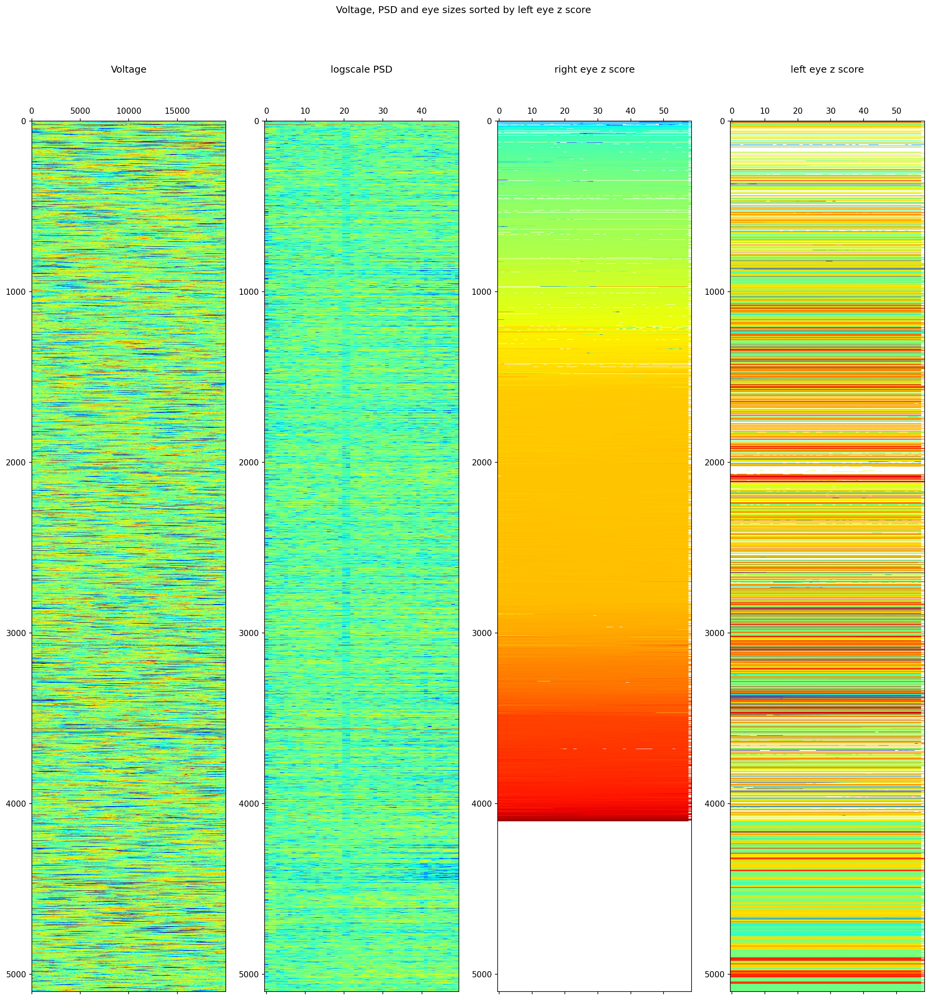

In [160]:
#a = np.array([5,2,3,5,1,6,2,3])
#idx = np.argsort(a)
mean_pupil_sizes_r = np.nanmean(rz_stack,axis=1) # This gives me the mean of every row in the stack which I can use as a sorting aid
mean_pupil_sizes_l = np.nanmean(lz_stack,axis=1)
all_df['r_mean_pupil_size'] = mean_pupil_sizes_r
all_df['l_mean_pupil_size'] = mean_pupil_sizes_l

r_idx = np.argsort(mean_pupil_sizes_r)

fig,ax = plt.subplots(dpi=150,figsize=(20,20),ncols=4)
ax[0].matshow(samples_array[r_idx],aspect='auto',vmin=-300,vmax=300,cmap='jet')
ax[0].set_title('Voltage')
ax[1].matshow(np.log(mean_pxx_stack[r_idx][:,0:50]),vmin=-5,vmax=5, aspect='auto',cmap='jet')
ax[1].set_title('logscale PSD')
ax[2].matshow(rz_stack[r_idx],aspect='auto',cmap='jet')
ax[2].set_title('right eye z score')
ax[3].matshow(lz_stack[r_idx],aspect='auto',cmap='jet')
ax[3].set_title('left eye z score')
fig.suptitle('Voltage, PSD and eye sizes sorted by left eye z score')
#plt.savefig(r'D:\MarkS3\Pictures\Graphs\Pupil_PSD_Graphs_Version2\Voltage_PSD_and_eye_sizes_sorted_by_left_eye_z_score.png')
#plt.colorbar(mappable=mappable)

In [97]:
fs_stack

array([[5.85734007e+01, 1.98449004e+02, 2.23102984e+02, ...,
        2.86782449e-03, 2.58564156e-03, 1.91417603e-03],
       [4.89726405e+01, 3.35536308e+02, 1.95720331e+02, ...,
        3.16348285e-03, 5.99492768e-03, 5.39065734e-03],
       [1.34623891e+02, 6.97261070e+02, 2.38044151e+02, ...,
        1.95746123e-03, 2.34727949e-03, 2.06510420e-03],
       ...,
       [5.21064517e+02, 1.77229709e+03, 5.25578629e+02, ...,
        1.39326762e-03, 1.28835252e-03, 4.80037373e-04],
       [4.05556281e+02, 3.74209607e+03, 1.64126798e+03, ...,
        1.92026555e-03, 3.82368642e-03, 2.70368138e-03],
       [1.82135086e+02, 2.19238866e+03, 4.98706250e+02, ...,
        5.22771292e-03, 6.59338299e-03, 2.29630628e-03]])

In [8]:
# use this to export the data:
"""
all_df.to_csv(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df.csv',index=False)
np.save(pathlib.Path(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df_samples.npy'),samples_array)
np.save(pathlib.Path(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df_le_z_scores.npy'),lz_stack)
np.save(pathlib.Path(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df_re_z_scores.npy'),rz_stack)

np.save(pathlib.Path(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df_pxx.npy'),pxx_stack)
np.save(pathlib.Path(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df_fs.npy'),fs_stack)
"""
# use this to import the data
fs_stack = np.load(pathlib.Path(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df_fs.npy'))
pxx_stack = np.load(pathlib.Path(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df_pxx.npy'))
all_df = pd.read_csv(r'D:\PythonCach\Pupil_PSD_Graphs_version2\annotations_df.csv')

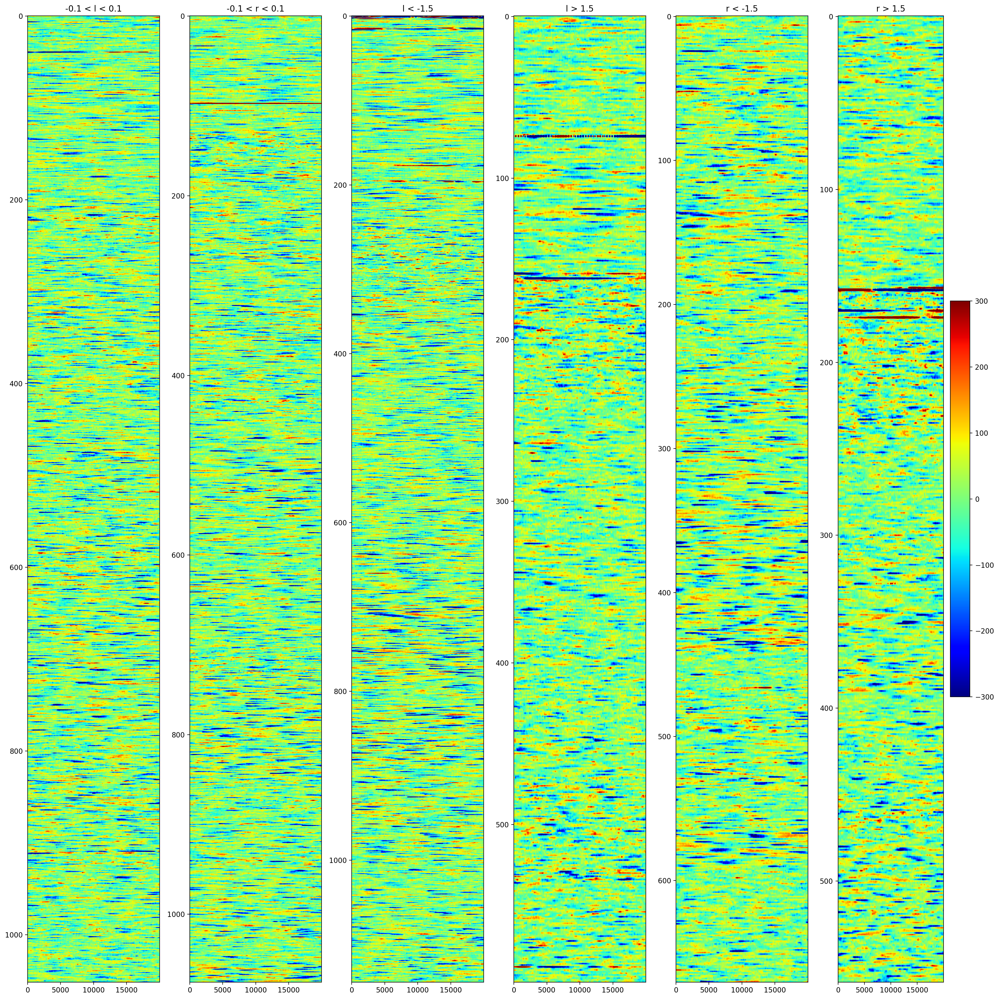

In [41]:
# plot here
cats = np.unique(all_df.cond)
fig, axes = plt.subplots(dpi=200,figsize=(20,20),ncols=len(cats))
for i, condition in enumerate(cats):
    mappable_ax = axes[i].imshow(samples_array[all_df['cond'] == condition],aspect='auto',vmin=-300,vmax=300,cmap='jet')
    axes[i].set_title(condition)
    axes[i].set_aspect('auto')
plt.colorbar(mappable_ax,location=)
plt.tight_layout(h_pad=10)

In [9]:
# create the PSD mean plot from before:
x_axis = fs_stack[0]
mean_psd_dict = {}
for cond in np.unique(all_df['cond']):
    boolean = all_df['cond'] == cond
    pxx_mean = np.mean(pxx_stack[boolean],axis=0)
    mean_psd_dict[cond] = pxx_mean

# get specific conditions from the existing dataframe:
both_eyes_large_idx = all_df.query('r_mean_pupil_size > 1.5 and l_mean_pupil_size > 1.5').index
both_eyes_small_idx = all_df.query('r_mean_pupil_size < -1.5 and l_mean_pupil_size < -1.5').index
mean_psd_dict['both eyes >1.2'] = np.mean(pxx_stack[both_eyes_large_idx],axis=0)
mean_psd_dict['both eyes <1.2'] = np.mean(pxx_stack[both_eyes_small_idx],axis=0)

fig, ax = plt.subplots(figsize=(10,5),dpi=150)
ax.set_xlim(1,250)
plt.yscale('log')
color_list = ['blue','cyan','red','green','yellow','purple','olive','snow']
for i, k in enumerate(mean_psd_dict.keys()):
    plt.plot(x_axis,mean_psd_dict[k],color=color_list[i],label=k)

ax.set_xlabel('Frequency')
ax.set_ylabel('Log Pxx')
plt.legend()
fig.suptitle('PSD for different pupil sizes')
ax.grid(which='both',axis='both',alpha=0.3)
#plt.savefig(r'D:\MarkS3\Pictures\Graphs\Pupil_PSD_Graphs_Version2\PSD_for_different_pupil_sizes.png')

UndefinedVariableError: name 'r_mean_pupil_size' is not defined

In [10]:
all_df

,rising,falling,block,cond
0,9734547.0,9754547.0,6,r > 1.5
1,9754547.0,9774547.0,6,r > 1.5
2,10373417.0,10393417.0,6,r > 1.5
3,11223513.0,11243513.0,6,r > 1.5
4,11243513.0,11263513.0,6,r > 1.5
...,...,...,...,...
5096,157637234.0,157657234.0,26,-0.1 < r < 0.1
5097,160240102.0,160260102.0,26,-0.1 < r < 0.1
5098,164199851.0,164219851.0,26,-0.1 < r < 0.1
5099,164219851.0,164239851.0,26,-0.1 < r < 0.1


In [178]:
# Create a gaussian smoothed z-score dataframe
block = blocklist[0]
if sum(block.re_df['Arena_TTL'] == block.le_df['Arena_TTL']) == len(block.re_df): # check that timestamps are actually aligned
    # get both eye data
    df = block.le_df[['Arena_TTL','ms_axis']] # create a dataframe with joint Arena_TTL vector as EP identifier

    df.insert(loc=1,column='block_num',value=block.block_num) # keep block numbers for later


    # get right eye pupil area values
    right_vals = (block.re_df['ellipse_size']*block.R_pix_size).values
    # smooth them out:
    right_vals = median_filter(right_vals,60)
    z_right = (right_vals - np.nanmean(right_vals)) / np.nanstd(right_vals)

    # get left eye values
    left_vals = (block.le_df['ellipse_size']*block.L_pix_size).values
    # smooth them out:
    left_vals = median_filter(left_vals,60)
    z_left = (left_vals - np.nanmean(left_vals)) / np.nanstd(left_vals)

    df.insert(loc=1,column='re_pupil_z',value=z_right)
    df.insert(loc=1,column='le_pupil_z',value=z_left)



In [122]:
# create a dataframe with regularly sized segments

upper_threshold = 1.5
cond_label = '>1.5'

r_high = df['re_pupil_z'].values > upper_threshold
l_high = df['le_pupil_z'].values > upper_threshold

cond_rising = []
cond_falling = []
rising, falling = get_rising_falling_edges(l_high)
rising_ttls = df['Arena_TTL'][rising].values
falling_ttls = df['Arena_TTL'][falling].values
segments_length = falling_ttls - rising_ttls
for i in range(len(segments_length)):
    seg_len = segments_length[i]
    if  seg_len < cond_len:
        continue
    else:
        #calculate how many chunks can be fully extracted:
        chunks = int(seg_len // cond_len)
        for c in range(chunks):
            chunk_starts = rising_ttls[i]+(c*cond_len)
            chunk_ends = chunk_starts + cond_len
            cond_rising.append(chunk_starts)
            cond_falling.append(chunk_ends)
scdf = pd.DataFrame(data={  'rising':cond_rising,
                            'falling':cond_falling,
                            'block':block.block_num,
                            'cond':cond_label
                                })
scdf

,rising,falling,block,cond
0,4207644.0,4227644.0,006,>1.5
1,4227644.0,4247644.0,006,>1.5
2,4247644.0,4267644.0,006,>1.5
3,4267644.0,4287644.0,006,>1.5
4,4310714.0,4330714.0,006,>1.5
...,...,...,...,...
81,21961851.0,21981851.0,006,>1.5
82,21981851.0,22001851.0,006,>1.5
83,22001851.0,22021851.0,006,>1.5
84,22094681.0,22114681.0,006,>1.5


In [123]:
df.columns

Index(['Arena_TTL', 'le_pupil_z', 're_pupil_z', 'block_num', 'ms_axis'], dtype='object')

In [13]:
print(f'getting EP data from block {block.block_num}')
session = oea.Session(str(block.oe_path.parent))
data = session.recordnodes[0].recordings[0].continuous[0].samples[:,17]
timestamps = session.recordnodes[0].recordings[0].continuous[0].timestamps
print('done')

getting EP data from block 006
done


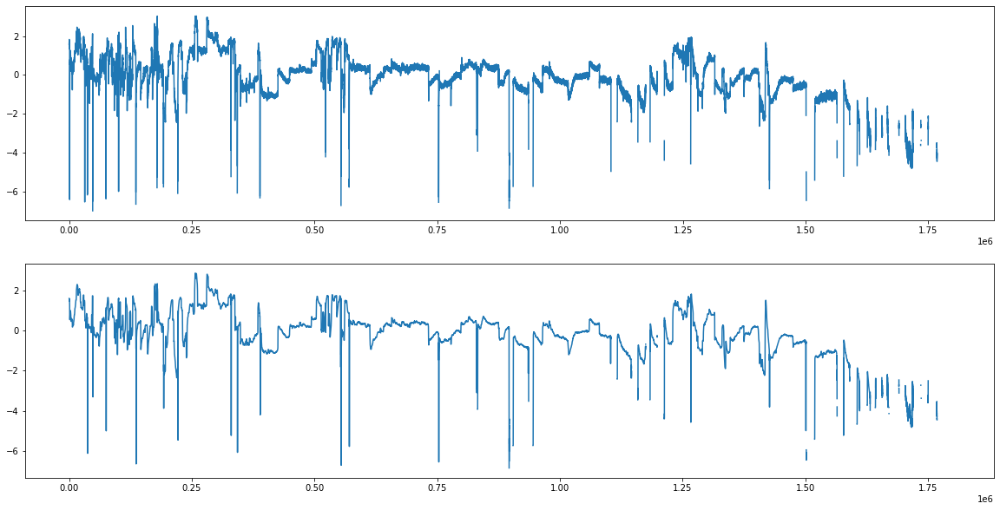

In [70]:
fig, axes = plt.subplots(figsize=(20,10),nrows=2)

axes[0].plot(df['ms_axis'],df['re_pupil_z'])
axes[1].plot(df['ms_axis'],median_filter(df['re_pupil_z'],60))

In [53]:
df['ms_axis'][segment]

0           0.00
3600    61407.15
Name: ms_axis, dtype: float64

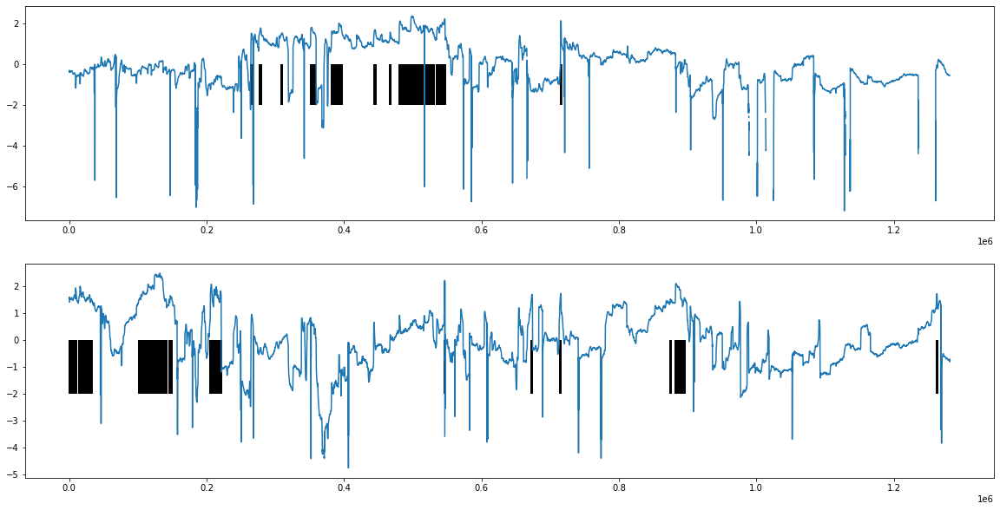

In [72]:
# explore the behavior
upper_threshold = 1.5
r_high = df['re_pupil_z'].values > upper_threshold
l_high = df['le_pupil_z'].values > upper_threshold

fig, axes = plt.subplots(figsize=(20,10),nrows=2)
axes[0].plot(df['ms_axis'],df['re_pupil_z'])
axes[1].plot(df['ms_axis'],df['le_pupil_z'])
axes[0].vlines(df['ms_axis'][r_high],-2,0)
axes[1].vlines(df['ms_axis'][l_high],-2,0)

In [23]:
df['ms_axis'][r_high]

15505    264586.20
15506    264603.25
15507    264620.35
15528    264978.70
15529    264995.75
           ...    
41963    716046.95
41964    716064.00
41965    716081.05
42001    716695.30
42002    716712.35
Name: ms_axis, Length: 5228, dtype: float64